In [1]:
import zipfile
import h5py
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, f1_score, recall_score
import tensorflow as tf
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input, decode_predictions
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.regularizers import l2
from keras.utils import to_categorical

%matplotlib inline
np.random.seed(42)

In [2]:
# Parameter
IMAGE_WIDTH = 224
IMAGE_HEIGHT = 224
COLOR_CHANNELS = 3
BATCH_SIZE = 32
EPOCHS = 25
K = 5  # Jumlah fold

In [5]:
data_dir = train_dir

# Membuat dataframe dari dataset
image_paths = []
labels = []

for class_name in os.listdir(data_dir):
    class_dir = os.path.join(data_dir, class_name)
    if os.path.isdir(class_dir):  
        for img_name in os.listdir(class_dir):
            image_paths.append(os.path.join(class_dir, img_name))
            labels.append(class_name)

df = pd.DataFrame({"filename": image_paths, "class": labels})

# Konversi label ke angka
label_encoder = LabelEncoder()
df["label"] = label_encoder.fit_transform(df["class"])

print("✅ Dataset berhasil dimuat! Jumlah data:", len(df))
pd.set_option('display.max_colwidth', None)
df.head(len(df))

✅ Dataset berhasil dimuat! Jumlah data: 7000


,filename,class,label
0,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1000_Mega_Mendung_155.jpg,JawaBarat_Megamendung,0
1,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1001_Mega_Mendung_159.jpg,JawaBarat_Megamendung,0
2,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1002_Mega_Mendung_160.jpg,JawaBarat_Megamendung,0
3,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1003_Mega_Mendung_161.jpg,JawaBarat_Megamendung,0
4,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1004_Mega_Mendung_164.jpg,JawaBarat_Megamendung,0
...,...,...,...
6995,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\Yogyakarta_Kawung\Kawung_92.jpg,Yogyakarta_Kawung,6
6996,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\Yogyakarta_Kawung\Kawung_93.jpg,Yogyakarta_Kawung,6
6997,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\Yogyakarta_Kawung\Kawung_94.jpg,Yogyakarta_Kawung,6
6998,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\Yogyakarta_Kawung\Kawung_96.jpg,Yogyakarta_Kawung,6


In [7]:
# Fungsi untuk membuat model MobileNetV2
def create_model():
    base_model = tf.keras.applications.mobilenet_v2.MobileNetV2(
        weights="imagenet", include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS)
    )
    
    base_model.trainable = False

    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    
    # Menambahkan layer output dengan weight decay
    predictions = Dense(len(label_encoder.classes_), activation="softmax")(x)
    
    model = Model(inputs=base_model.input, outputs=predictions)

    # Compile model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

# Cek model
model = create_model()
model.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,266,951 (8.65 MB)

 Trainable params: 8,967 (35.03 KB)

 Non-trainable params: 2,257,984 (8.61 MB)


🔹 Training Fold 1/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
  1/175 ━━━━━━━━━━━━━━━━━━━━ 13:05 5s/step - accuracy: 0.1875 - loss: 2.3148

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 696ms/step - accuracy: 0.6600 - loss: 0.9841
Epoch 1: val_loss improved from inf to 0.26613, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 158s 882ms/step - accuracy: 0.6609 - loss: 0.9819 - val_accuracy: 0.9321 - val_loss: 0.2661
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step - accuracy: 0.9447 - loss: 0.2200
Epoch 2: val_loss improved from 0.26613 to 0.18875, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 846ms/step - accuracy: 0.9447 - loss: 0.2199 - val_accuracy: 0.9493 - val_loss: 0.1887
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 693ms/step - accuracy: 0.9669 - loss: 0.1449
Epoch 3: val_loss improved from 0.18875 to 0.16514, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 152s 871ms/step - accuracy: 0.9669 - loss: 0.1449 - val_accuracy: 0.9579 - val_loss: 0.1651
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - accuracy: 0.9786 - loss: 0.1087
Epoch 4: val_loss improved from 0.16514 to 0.14086, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 149s 854ms/step - accuracy: 0.9786 - loss: 0.1086 - val_accuracy: 0.9671 - val_loss: 0.1409
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 672ms/step - accuracy: 0.9815 - loss: 0.0838
Epoch 5: val_loss improved from 0.14086 to 0.13050, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 847ms/step - accuracy: 0.9815 - loss: 0.0838 - val_accuracy: 0.9686 - val_loss: 0.1305
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step - accuracy: 0.9866 - loss: 0.0699
Epoch 6: val_loss improved from 0.13050 to 0.11967, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 846ms/step - accuracy: 0.9866 - loss: 0.0698 - val_accuracy: 0.9686 - val_loss: 0.1197
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 668ms/step - accuracy: 0.9928 - loss: 0.0565
Epoch 7: val_loss did not improve from 0.11967
175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 842ms/step - accuracy: 0.9927 - loss: 0.0565 - val_accuracy: 0.9700 - val_loss: 0.1227
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 666ms/step - accuracy: 0.9917 - loss: 0.0477
Epoch 8: val_loss improved from 0.11967 to 0.11328, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 842ms/step - accuracy: 0.9917 - loss: 0.0477 - val_accuracy: 0.9729 - val_loss: 0.1133
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 672ms/step - accuracy: 0.9925 - loss: 0.0434
Epoch 9: val_loss improved from 0.11328 to 0.11264, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 847ms/step - accuracy: 0.9925 - loss: 0.0434 - val_accuracy: 0.9729 - val_loss: 0.1126
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 669ms/step - accuracy: 0.9962 - loss: 0.0329
Epoch 10: val_loss improved from 0.11264 to 0.10822, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 845ms/step - accuracy: 0.9962 - loss: 0.0330 - val_accuracy: 0.9757 - val_loss: 0.1082
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step - accuracy: 0.9971 - loss: 0.0315
Epoch 11: val_loss improved from 0.10822 to 0.10625, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 847ms/step - accuracy: 0.9971 - loss: 0.0315 - val_accuracy: 0.9714 - val_loss: 0.1063
Epoch 12/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step - accuracy: 0.9969 - loss: 0.0271
Epoch 12: val_loss improved from 0.10625 to 0.10563, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 846ms/step - accuracy: 0.9969 - loss: 0.0271 - val_accuracy: 0.9736 - val_loss: 0.1056
Epoch 13/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 668ms/step - accuracy: 0.9966 - loss: 0.0248
Epoch 13: val_loss improved from 0.10563 to 0.10437, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 844ms/step - accuracy: 0.9966 - loss: 0.0248 - val_accuracy: 0.9757 - val_loss: 0.1044
Epoch 14/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 668ms/step - accuracy: 0.9993 - loss: 0.0195
Epoch 14: val_loss improved from 0.10437 to 0.10222, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 844ms/step - accuracy: 0.9993 - loss: 0.0195 - val_accuracy: 0.9764 - val_loss: 0.1022
Epoch 15/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 669ms/step - accuracy: 0.9983 - loss: 0.0204
Epoch 15: val_loss improved from 0.10222 to 0.10124, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 844ms/step - accuracy: 0.9983 - loss: 0.0204 - val_accuracy: 0.9757 - val_loss: 0.1012
Epoch 16/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step - accuracy: 0.9991 - loss: 0.0164
Epoch 16: val_loss did not improve from 0.10124
175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 845ms/step - accuracy: 0.9991 - loss: 0.0164 - val_accuracy: 0.9729 - val_loss: 0.1032
Epoch 17/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 668ms/step - accuracy: 0.9992 - loss: 0.0146
Epoch 17: val_loss improved from 0.10124 to 0.10047, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 842ms/step - accuracy: 0.9992 - loss: 0.0146 - val_accuracy: 0.9771 - val_loss: 0.1005
Epoch 18/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 669ms/step - accuracy: 0.9990 - loss: 0.0131
Epoch 18: val_loss did not improve from 0.10047
175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 842ms/step - accuracy: 0.9990 - loss: 0.0131 - val_accuracy: 0.9750 - val_loss: 0.1022
Epoch 19/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 665ms/step - accuracy: 0.9990 - loss: 0.0123
Epoch 19: val_loss did not improve from 0.10047
175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 838ms/step - accuracy: 0.9990 - loss: 0.0123 - val_accuracy: 0.9750 - val_loss: 0.1029
Epoch 20/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 665ms/step - accuracy: 0.9999 - loss: 0.0098
Epoch 20: val_loss did not improve from 0.10047
175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 838ms/step - accuracy: 0.9999 - loss: 0.0098 - val_accuracy: 0.9743 - val_loss: 0.1043
Epoch 21/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 667ms/step - accuracy: 1.0000 - loss: 0.0094
Epoch 21: val_lo

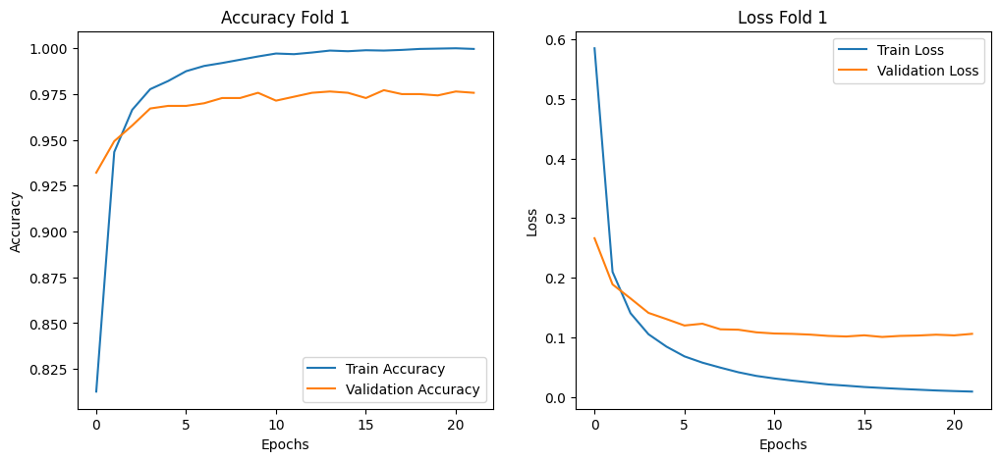


🔹 Training Fold 2/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.
Epoch 1/25


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


 22/175 ━━━━━━━━━━━━━━━━━━━━ 1:41 662ms/step - accuracy: 0.2429 - loss: 2.1642

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 665ms/step - accuracy: 0.6227 - loss: 1.1117
Epoch 1: val_loss improved from inf to 0.30276, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 151s 844ms/step - accuracy: 0.6236 - loss: 1.1091 - val_accuracy: 0.9129 - val_loss: 0.3028
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 667ms/step - accuracy: 0.9386 - loss: 0.2414
Epoch 2: val_loss improved from 0.30276 to 0.21445, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 840ms/step - accuracy: 0.9386 - loss: 0.2413 - val_accuracy: 0.9364 - val_loss: 0.2144
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 669ms/step - accuracy: 0.9629 - loss: 0.1491
Epoch 3: val_loss improved from 0.21445 to 0.17440, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 842ms/step - accuracy: 0.9629 - loss: 0.1491 - val_accuracy: 0.9500 - val_loss: 0.1744
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step - accuracy: 0.9741 - loss: 0.1104
Epoch 4: val_loss improved from 0.17440 to 0.15413, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 844ms/step - accuracy: 0.9741 - loss: 0.1104 - val_accuracy: 0.9571 - val_loss: 0.1541
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 719ms/step - accuracy: 0.9835 - loss: 0.0889
Epoch 5: val_loss improved from 0.15413 to 0.14137, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 156s 893ms/step - accuracy: 0.9835 - loss: 0.0889 - val_accuracy: 0.9593 - val_loss: 0.1414
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 670ms/step - accuracy: 0.9866 - loss: 0.0717
Epoch 6: val_loss improved from 0.14137 to 0.13837, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 148s 842ms/step - accuracy: 0.9866 - loss: 0.0717 - val_accuracy: 0.9607 - val_loss: 0.1384
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 670ms/step - accuracy: 0.9900 - loss: 0.0593
Epoch 7: val_loss improved from 0.13837 to 0.13166, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 843ms/step - accuracy: 0.9900 - loss: 0.0593 - val_accuracy: 0.9586 - val_loss: 0.1317
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 669ms/step - accuracy: 0.9927 - loss: 0.0480
Epoch 8: val_loss improved from 0.13166 to 0.12252, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 842ms/step - accuracy: 0.9927 - loss: 0.0480 - val_accuracy: 0.9629 - val_loss: 0.1225
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 676ms/step - accuracy: 0.9936 - loss: 0.0418
Epoch 9: val_loss improved from 0.12252 to 0.11857, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 149s 850ms/step - accuracy: 0.9936 - loss: 0.0418 - val_accuracy: 0.9643 - val_loss: 0.1186
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 676ms/step - accuracy: 0.9946 - loss: 0.0354
Epoch 10: val_loss improved from 0.11857 to 0.11578, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 149s 849ms/step - accuracy: 0.9946 - loss: 0.0354 - val_accuracy: 0.9636 - val_loss: 0.1158
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 673ms/step - accuracy: 0.9970 - loss: 0.0274
Epoch 11: val_loss did not improve from 0.11578
175/175 ━━━━━━━━━━━━━━━━━━━━ 149s 853ms/step - accuracy: 0.9970 - loss: 0.0274 - val_accuracy: 0.9657 - val_loss: 0.1188
Epoch 12/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 680ms/step - accuracy: 0.9986 - loss: 0.0247
Epoch 12: val_loss improved from 0.11578 to 0.11444, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 149s 849ms/step - accuracy: 0.9986 - loss: 0.0247 - val_accuracy: 0.9629 - val_loss: 0.1144
Epoch 13/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9980 - loss: 0.0236
Epoch 13: val_loss did not improve from 0.11444
175/175 ━━━━━━━━━━━━━━━━━━━━ 144s 824ms/step - accuracy: 0.9980 - loss: 0.0236 - val_accuracy: 0.9643 - val_loss: 0.1153
Epoch 14/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9992 - loss: 0.0200
Epoch 14: val_loss did not improve from 0.11444
175/175 ━━━━━━━━━━━━━━━━━━━━ 144s 824ms/step - accuracy: 0.9992 - loss: 0.0200 - val_accuracy: 0.9650 - val_loss: 0.1152
Epoch 15/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 662ms/step - accuracy: 0.9996 - loss: 0.0176
Epoch 15: val_loss improved from 0.11444 to 0.11424, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 831ms/step - accuracy: 0.9996 - loss: 0.0176 - val_accuracy: 0.9650 - val_loss: 0.1142
Epoch 16/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9999 - loss: 0.0159
Epoch 16: val_loss improved from 0.11424 to 0.11255, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9999 - loss: 0.0159 - val_accuracy: 0.9650 - val_loss: 0.1125
Epoch 17/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 1.0000 - loss: 0.0143
Epoch 17: val_loss did not improve from 0.11255
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 1.0000 - loss: 0.0143 - val_accuracy: 0.9636 - val_loss: 0.1151
Epoch 18/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 1.0000 - loss: 0.0123
Epoch 18: val_loss did not improve from 0.11255
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 1.0000 - loss: 0.0123 - val_accuracy: 0.9643 - val_loss: 0.1130
Epoch 19/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 1.0000 - loss: 0.0107
Epoch 19: val_loss improved from 0.11255 to 0.11172, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 1.0000 - loss: 0.0107 - val_accuracy: 0.9636 - val_loss: 0.1117
Epoch 20/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 1.0000 - loss: 0.0092
Epoch 20: val_loss did not improve from 0.11172
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 1.0000 - loss: 0.0092 - val_accuracy: 0.9679 - val_loss: 0.1124
Epoch 21/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9999 - loss: 0.0085
Epoch 21: val_loss did not improve from 0.11172
175/175 ━━━━━━━━━━━━━━━━━━━━ 144s 824ms/step - accuracy: 0.9999 - loss: 0.0085 - val_accuracy: 0.9643 - val_loss: 0.1152
Epoch 22/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 1.0000 - loss: 0.0079
Epoch 22: val_loss did not improve from 0.11172
175/175 ━━━━━━━━━━━━━━━━━━━━ 144s 823ms/step - accuracy: 1.0000 - loss: 0.0079 - val_accuracy: 0.9671 - val_loss: 0.1145
Epoch 23/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 1.0000 - loss: 0.0073
Epoch 23: val_lo

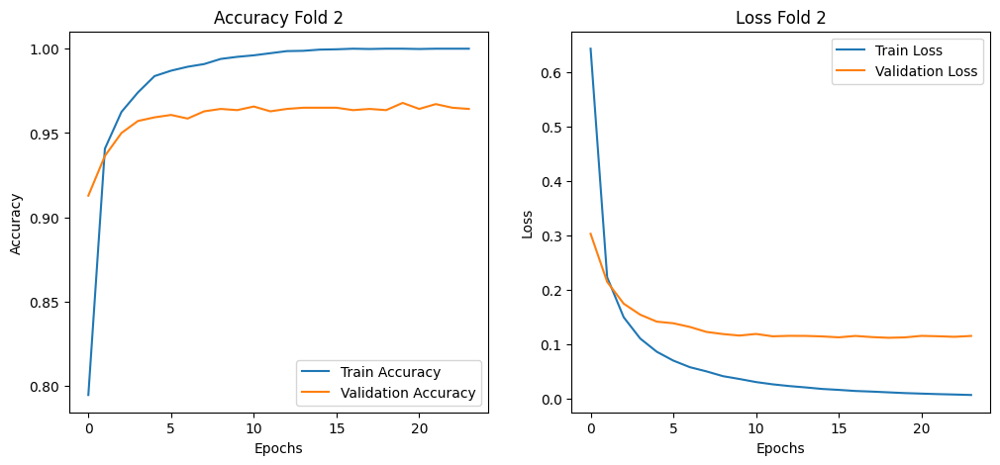


🔹 Training Fold 3/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
111/175 ━━━━━━━━━━━━━━━━━━━━ 42s 659ms/step - accuracy: 0.5792 - loss: 1.2048

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 0.6533 - loss: 1.0061
Epoch 1: val_loss improved from inf to 0.33248, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 150s 838ms/step - accuracy: 0.6542 - loss: 1.0037 - val_accuracy: 0.8957 - val_loss: 0.3325
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9425 - loss: 0.2252
Epoch 2: val_loss improved from 0.33248 to 0.23440, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9425 - loss: 0.2252 - val_accuracy: 0.9343 - val_loss: 0.2344
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 0.9639 - loss: 0.1418
Epoch 3: val_loss improved from 0.23440 to 0.18471, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 832ms/step - accuracy: 0.9639 - loss: 0.1418 - val_accuracy: 0.9479 - val_loss: 0.1847
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 0.9771 - loss: 0.1047
Epoch 4: val_loss improved from 0.18471 to 0.16775, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9771 - loss: 0.1047 - val_accuracy: 0.9586 - val_loss: 0.1677
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9849 - loss: 0.0760
Epoch 5: val_loss improved from 0.16775 to 0.14283, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9849 - loss: 0.0761 - val_accuracy: 0.9607 - val_loss: 0.1428
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 0.9901 - loss: 0.0657
Epoch 6: val_loss improved from 0.14283 to 0.14183, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 831ms/step - accuracy: 0.9901 - loss: 0.0657 - val_accuracy: 0.9621 - val_loss: 0.1418
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9930 - loss: 0.0547
Epoch 7: val_loss improved from 0.14183 to 0.12545, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9930 - loss: 0.0547 - val_accuracy: 0.9636 - val_loss: 0.1255
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9938 - loss: 0.0450
Epoch 8: val_loss did not improve from 0.12545
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9938 - loss: 0.0450 - val_accuracy: 0.9664 - val_loss: 0.1302
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9951 - loss: 0.0391
Epoch 9: val_loss did not improve from 0.12545
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9951 - loss: 0.0391 - val_accuracy: 0.9629 - val_loss: 0.1320
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9962 - loss: 0.0367
Epoch 10: val_loss improved from 0.12545 to 0.11622, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9962 - loss: 0.0367 - val_accuracy: 0.9671 - val_loss: 0.1162
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9972 - loss: 0.0272
Epoch 11: val_loss did not improve from 0.11622
175/175 ━━━━━━━━━━━━━━━━━━━━ 144s 826ms/step - accuracy: 0.9972 - loss: 0.0272 - val_accuracy: 0.9657 - val_loss: 0.1171
Epoch 12/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9981 - loss: 0.0256
Epoch 12: val_loss improved from 0.11622 to 0.11339, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9981 - loss: 0.0256 - val_accuracy: 0.9671 - val_loss: 0.1134
Epoch 13/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9976 - loss: 0.0240
Epoch 13: val_loss did not improve from 0.11339
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9976 - loss: 0.0240 - val_accuracy: 0.9679 - val_loss: 0.1152
Epoch 14/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 0.9989 - loss: 0.0194
Epoch 14: val_loss did not improve from 0.11339
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9989 - loss: 0.0194 - val_accuracy: 0.9636 - val_loss: 0.1146
Epoch 15/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9992 - loss: 0.0193
Epoch 15: val_loss improved from 0.11339 to 0.10749, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9992 - loss: 0.0193 - val_accuracy: 0.9657 - val_loss: 0.1075
Epoch 16/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 0.9995 - loss: 0.0153
Epoch 16: val_loss did not improve from 0.10749
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9995 - loss: 0.0153 - val_accuracy: 0.9650 - val_loss: 0.1096
Epoch 17/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9995 - loss: 0.0139
Epoch 17: val_loss did not improve from 0.10749
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9995 - loss: 0.0139 - val_accuracy: 0.9650 - val_loss: 0.1168
Epoch 18/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9992 - loss: 0.0122
Epoch 18: val_loss did not improve from 0.10749
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9992 - loss: 0.0122 - val_accuracy: 0.9643 - val_loss: 0.1135
Epoch 19/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9997 - loss: 0.0115
Epoch 19: val_lo

175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9997 - loss: 0.0115 - val_accuracy: 0.9664 - val_loss: 0.1049
Epoch 20/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 0.9998 - loss: 0.0099
Epoch 20: val_loss did not improve from 0.10495
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9998 - loss: 0.0099 - val_accuracy: 0.9671 - val_loss: 0.1051
Epoch 21/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 0.9998 - loss: 0.0093
Epoch 21: val_loss did not improve from 0.10495
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9998 - loss: 0.0093 - val_accuracy: 0.9657 - val_loss: 0.1125
Epoch 22/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 0.9996 - loss: 0.0089
Epoch 22: val_loss did not improve from 0.10495
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9996 - loss: 0.0089 - val_accuracy: 0.9643 - val_loss: 0.1139
Epoch 23/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 1.0000 - loss: 0.0073
Epoch 23: val_lo

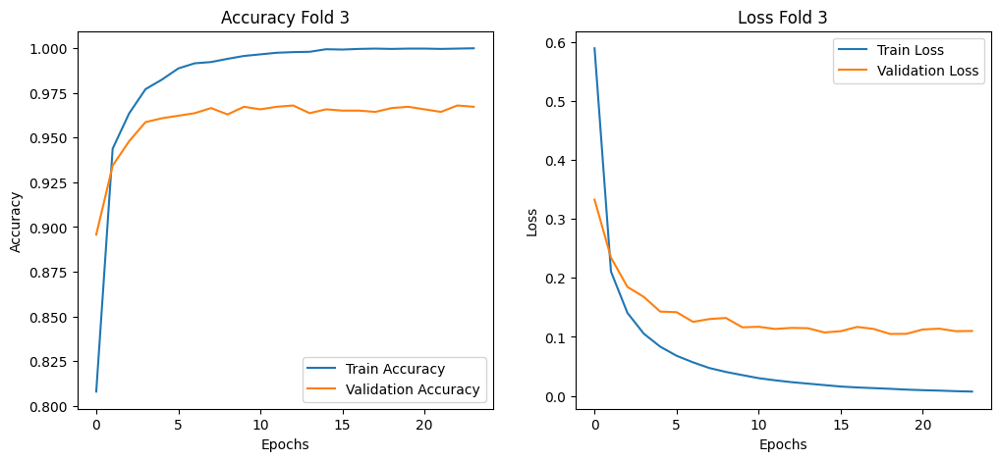


🔹 Training Fold 4/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.6485 - loss: 1.0296

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(



Epoch 1: val_loss improved from inf to 0.30662, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 150s 838ms/step - accuracy: 0.6494 - loss: 1.0272 - val_accuracy: 0.9121 - val_loss: 0.3066
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 662ms/step - accuracy: 0.9448 - loss: 0.2259
Epoch 2: val_loss improved from 0.30662 to 0.21572, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 841ms/step - accuracy: 0.9448 - loss: 0.2258 - val_accuracy: 0.9414 - val_loss: 0.2157
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 663ms/step - accuracy: 0.9642 - loss: 0.1526
Epoch 3: val_loss improved from 0.21572 to 0.18599, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 838ms/step - accuracy: 0.9642 - loss: 0.1525 - val_accuracy: 0.9450 - val_loss: 0.1860
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 0.9729 - loss: 0.1175
Epoch 4: val_loss improved from 0.18599 to 0.16328, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9729 - loss: 0.1175 - val_accuracy: 0.9529 - val_loss: 0.1633
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 0.9846 - loss: 0.0836
Epoch 5: val_loss improved from 0.16328 to 0.14903, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9846 - loss: 0.0836 - val_accuracy: 0.9614 - val_loss: 0.1490
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9876 - loss: 0.0708
Epoch 6: val_loss improved from 0.14903 to 0.13347, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9876 - loss: 0.0708 - val_accuracy: 0.9600 - val_loss: 0.1335
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9925 - loss: 0.0552
Epoch 7: val_loss did not improve from 0.13347
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9925 - loss: 0.0552 - val_accuracy: 0.9621 - val_loss: 0.1335
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 0.9937 - loss: 0.0478
Epoch 8: val_loss improved from 0.13347 to 0.13096, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9937 - loss: 0.0478 - val_accuracy: 0.9629 - val_loss: 0.1310
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 654ms/step - accuracy: 0.9944 - loss: 0.0412
Epoch 9: val_loss improved from 0.13096 to 0.12554, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9944 - loss: 0.0412 - val_accuracy: 0.9629 - val_loss: 0.1255
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9968 - loss: 0.0347
Epoch 10: val_loss improved from 0.12554 to 0.12152, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9968 - loss: 0.0347 - val_accuracy: 0.9636 - val_loss: 0.1215
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9965 - loss: 0.0318
Epoch 11: val_loss did not improve from 0.12152
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9965 - loss: 0.0318 - val_accuracy: 0.9657 - val_loss: 0.1249
Epoch 12/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9965 - loss: 0.0285
Epoch 12: val_loss improved from 0.12152 to 0.11842, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 147s 839ms/step - accuracy: 0.9965 - loss: 0.0285 - val_accuracy: 0.9671 - val_loss: 0.1184
Epoch 13/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 684ms/step - accuracy: 0.9983 - loss: 0.0227
Epoch 13: val_loss did not improve from 0.11842
175/175 ━━━━━━━━━━━━━━━━━━━━ 150s 857ms/step - accuracy: 0.9983 - loss: 0.0227 - val_accuracy: 0.9664 - val_loss: 0.1208
Epoch 14/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9978 - loss: 0.0214
Epoch 14: val_loss improved from 0.11842 to 0.11746, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 146s 833ms/step - accuracy: 0.9978 - loss: 0.0214 - val_accuracy: 0.9657 - val_loss: 0.1175
Epoch 15/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9993 - loss: 0.0183
Epoch 15: val_loss did not improve from 0.11746
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 831ms/step - accuracy: 0.9993 - loss: 0.0183 - val_accuracy: 0.9664 - val_loss: 0.1193
Epoch 16/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 0.9994 - loss: 0.0165
Epoch 16: val_loss did not improve from 0.11746
175/175 ━━━━━━━━━━━━━━━━━━━━ 146s 832ms/step - accuracy: 0.9994 - loss: 0.0165 - val_accuracy: 0.9686 - val_loss: 0.1183
Epoch 17/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 0.9990 - loss: 0.0151
Epoch 17: val_loss did not improve from 0.11746
175/175 ━━━━━━━━━━━━━━━━━━━━ 146s 833ms/step - accuracy: 0.9990 - loss: 0.0151 - val_accuracy: 0.9693 - val_loss: 0.1192
Epoch 18/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9998 - loss: 0.0119
Epoch 18: val_lo

175/175 ━━━━━━━━━━━━━━━━━━━━ 146s 833ms/step - accuracy: 0.9998 - loss: 0.0112 - val_accuracy: 0.9671 - val_loss: 0.1171
Epoch 20/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9999 - loss: 0.0108
Epoch 20: val_loss did not improve from 0.11706
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9999 - loss: 0.0108 - val_accuracy: 0.9686 - val_loss: 0.1228
Epoch 21/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9996 - loss: 0.0104
Epoch 21: val_loss improved from 0.11706 to 0.11619, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 832ms/step - accuracy: 0.9996 - loss: 0.0104 - val_accuracy: 0.9686 - val_loss: 0.1162
Epoch 22/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 0.9999 - loss: 0.0078
Epoch 22: val_loss did not improve from 0.11619
175/175 ━━━━━━━━━━━━━━━━━━━━ 146s 832ms/step - accuracy: 0.9999 - loss: 0.0078 - val_accuracy: 0.9693 - val_loss: 0.1215
Epoch 23/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9998 - loss: 0.0077
Epoch 23: val_loss did not improve from 0.11619
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 832ms/step - accuracy: 0.9998 - loss: 0.0077 - val_accuracy: 0.9693 - val_loss: 0.1228
Epoch 24/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9999 - loss: 0.0078
Epoch 24: val_loss did not improve from 0.11619
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 831ms/step - accuracy: 0.9999 - loss: 0.0078 - val_accuracy: 0.9693 - val_loss: 0.1205
Epoch 25/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 1.0000 - loss: 0.0060
Epoch 25: val_lo

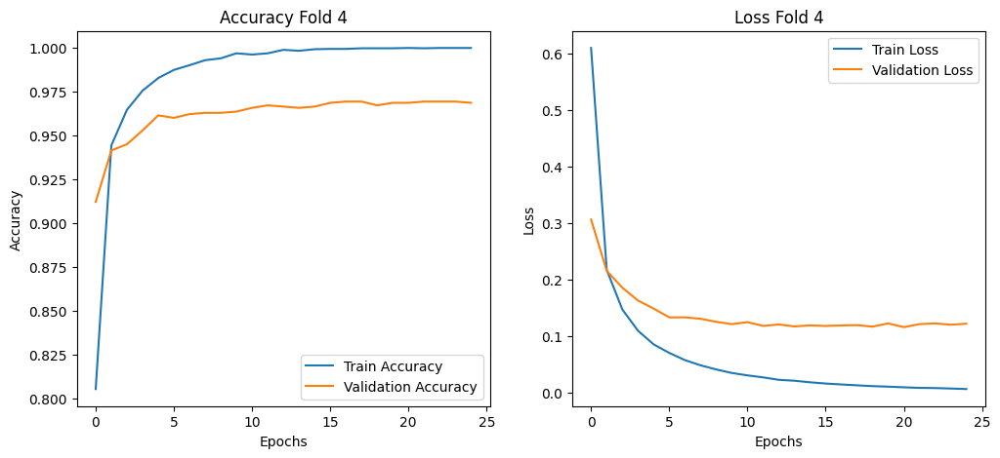


🔹 Training Fold 5/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
170/175 ━━━━━━━━━━━━━━━━━━━━ 3s 656ms/step - accuracy: 0.6168 - loss: 1.0974

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.6218 - loss: 1.0843
Epoch 1: val_loss improved from inf to 0.28080, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 149s 838ms/step - accuracy: 0.6228 - loss: 1.0817 - val_accuracy: 0.9129 - val_loss: 0.2808
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9291 - loss: 0.2533
Epoch 2: val_loss improved from 0.28080 to 0.19173, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 831ms/step - accuracy: 0.9292 - loss: 0.2532 - val_accuracy: 0.9436 - val_loss: 0.1917
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9607 - loss: 0.1590
Epoch 3: val_loss improved from 0.19173 to 0.15362, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 832ms/step - accuracy: 0.9607 - loss: 0.1590 - val_accuracy: 0.9550 - val_loss: 0.1536
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9796 - loss: 0.1033
Epoch 4: val_loss improved from 0.15362 to 0.14202, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9795 - loss: 0.1034 - val_accuracy: 0.9586 - val_loss: 0.1420
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 654ms/step - accuracy: 0.9802 - loss: 0.0918
Epoch 5: val_loss improved from 0.14202 to 0.12650, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9802 - loss: 0.0918 - val_accuracy: 0.9629 - val_loss: 0.1265
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 654ms/step - accuracy: 0.9883 - loss: 0.0699
Epoch 6: val_loss improved from 0.12650 to 0.12343, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9883 - loss: 0.0699 - val_accuracy: 0.9600 - val_loss: 0.1234
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 652ms/step - accuracy: 0.9903 - loss: 0.0618
Epoch 7: val_loss improved from 0.12343 to 0.11273, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9903 - loss: 0.0618 - val_accuracy: 0.9600 - val_loss: 0.1127
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9916 - loss: 0.0541
Epoch 8: val_loss did not improve from 0.11273
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9916 - loss: 0.0541 - val_accuracy: 0.9600 - val_loss: 0.1158
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9921 - loss: 0.0425
Epoch 9: val_loss improved from 0.11273 to 0.10685, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 831ms/step - accuracy: 0.9921 - loss: 0.0426 - val_accuracy: 0.9629 - val_loss: 0.1069
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 0.9965 - loss: 0.0355
Epoch 10: val_loss improved from 0.10685 to 0.10454, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9965 - loss: 0.0355 - val_accuracy: 0.9636 - val_loss: 0.1045
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 0.9974 - loss: 0.0299
Epoch 11: val_loss improved from 0.10454 to 0.10120, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9974 - loss: 0.0299 - val_accuracy: 0.9629 - val_loss: 0.1012
Epoch 12/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 0.9986 - loss: 0.0246
Epoch 12: val_loss did not improve from 0.10120
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 826ms/step - accuracy: 0.9986 - loss: 0.0246 - val_accuracy: 0.9650 - val_loss: 0.1024
Epoch 13/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9985 - loss: 0.0251
Epoch 13: val_loss improved from 0.10120 to 0.09424, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 146s 832ms/step - accuracy: 0.9985 - loss: 0.0251 - val_accuracy: 0.9650 - val_loss: 0.0942
Epoch 14/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 676ms/step - accuracy: 0.9995 - loss: 0.0202
Epoch 14: val_loss did not improve from 0.09424
175/175 ━━━━━━━━━━━━━━━━━━━━ 150s 860ms/step - accuracy: 0.9995 - loss: 0.0202 - val_accuracy: 0.9636 - val_loss: 0.1035
Epoch 15/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9981 - loss: 0.0217
Epoch 15: val_loss improved from 0.09424 to 0.09352, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 830ms/step - accuracy: 0.9981 - loss: 0.0216 - val_accuracy: 0.9607 - val_loss: 0.0935
Epoch 16/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 654ms/step - accuracy: 0.9986 - loss: 0.0175
Epoch 16: val_loss did not improve from 0.09352
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9986 - loss: 0.0175 - val_accuracy: 0.9664 - val_loss: 0.0968
Epoch 17/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9994 - loss: 0.0149
Epoch 17: val_loss did not improve from 0.09352
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9994 - loss: 0.0149 - val_accuracy: 0.9664 - val_loss: 0.0958
Epoch 18/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 654ms/step - accuracy: 0.9998 - loss: 0.0127
Epoch 18: val_loss did not improve from 0.09352
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9998 - loss: 0.0127 - val_accuracy: 0.9643 - val_loss: 0.0951
Epoch 19/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9999 - loss: 0.0124
Epoch 19: val_lo

175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9999 - loss: 0.0124 - val_accuracy: 0.9679 - val_loss: 0.0915
Epoch 20/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9998 - loss: 0.0109
Epoch 20: val_loss did not improve from 0.09146
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 827ms/step - accuracy: 0.9998 - loss: 0.0109 - val_accuracy: 0.9657 - val_loss: 0.0939
Epoch 21/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 0.9997 - loss: 0.0090
Epoch 21: val_loss improved from 0.09146 to 0.09077, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9997 - loss: 0.0090 - val_accuracy: 0.9664 - val_loss: 0.0908
Epoch 22/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9998 - loss: 0.0089
Epoch 22: val_loss did not improve from 0.09077
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 828ms/step - accuracy: 0.9998 - loss: 0.0089 - val_accuracy: 0.9686 - val_loss: 0.0943
Epoch 23/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9997 - loss: 0.0091
Epoch 23: val_loss did not improve from 0.09077
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9997 - loss: 0.0091 - val_accuracy: 0.9679 - val_loss: 0.0939
Epoch 24/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 655ms/step - accuracy: 0.9998 - loss: 0.0075
Epoch 24: val_loss did not improve from 0.09077
175/175 ━━━━━━━━━━━━━━━━━━━━ 145s 829ms/step - accuracy: 0.9998 - loss: 0.0075 - val_accuracy: 0.9693 - val_loss: 0.0912
Epoch 25/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9999 - loss: 0.0061
Epoch 25: val_lo

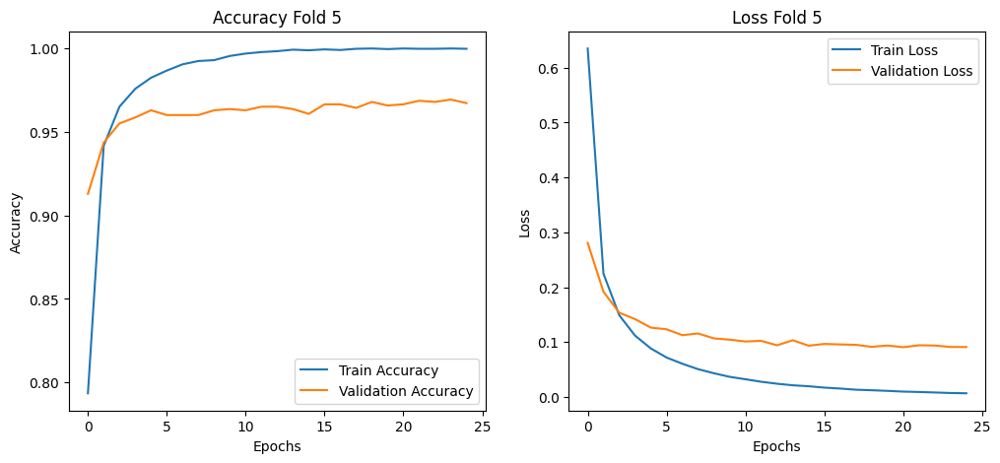


✅ Training selesai untuk semua fold!


In [8]:
# Stratified K-Fold
skf = StratifiedKFold(n_splits=K, shuffle=True, random_state=42)

# Melakukan K-Fold Cross Validation
for fold, (train_idx, val_idx) in enumerate(skf.split(df["filename"], df["label"])):
    print(f"\n🔹 Training Fold {fold+1}/{K}")

    # Membagi dataset berdasarkan indeks
    train_df = df.iloc[train_idx]
    val_df = df.iloc[val_idx]

    # Data augmentation dan preprocessing
    train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
    val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

    train_generator = train_datagen.flow_from_dataframe(
        train_df, x_col="filename", y_col="class",
        target_size=(IMAGE_HEIGHT, IMAGE_WIDTH), batch_size=BATCH_SIZE,
        class_mode="categorical", shuffle=True
    )

    val_generator = val_datagen.flow_from_dataframe(
        val_df, x_col="filename", y_col="class",
        target_size=(IMAGE_HEIGHT, IMAGE_WIDTH), batch_size=BATCH_SIZE,
        class_mode="categorical", shuffle=False
    )

    # Buat model baru untuk setiap fold
    model = create_model()

    # Callback untuk early stopping dan penyimpanan model terbaik
    early_stopping = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)
    model_checkpoint = ModelCheckpoint(f"Batik_Nusantara_7_MobileNetV2_Fold{fold+1}.h5",
                                       monitor="val_loss", save_best_only=True, mode="min", verbose=1)

    # Training model
    history = model.fit(
        train_generator,
        validation_data=val_generator,
        epochs=EPOCHS,
        callbacks=[early_stopping, model_checkpoint],
        verbose=1
    )

    # 🔹 Plot Training & Validation Accuracy untuk Fold ini
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'Accuracy Fold {fold+1}')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # 🔹 Plot Training & Validation Loss untuk Fold ini
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'Loss Fold {fold+1}')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()  # Menampilkan plot setelah setiap fold selesai

print("\n✅ Training selesai untuk semua fold!")


In [3]:
train_dir = '../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train'
test_dir = '../../Dataset/Dataset_Nusantara_7_augmented_1100_split/test'

# Preprocessing data testing
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    shuffle=False  # Agar urutan gambar tetap sama untuk semua model
)

# Evaluasi tiap model per fold
num_folds = 5  # Jumlah fold
models = [f"Batik_Nusantara_7_MobileNetV2_Fold{i+1}.h5" for i in range(num_folds)]

for i, model_path in enumerate(models):
    print(f"\n🔹 Evaluating Model Fold {i+1}: {model_path}")
    
    # Load model
    model = tf.keras.models.load_model(model_path)
    
    # Evaluasi model
    loss, accuracy = model.evaluate(test_generator, verbose=1)
    
    # Tampilkan hasil evaluasi
    print(f"✅ Fold {i+1}: Loss = {loss:.4f}, Accuracy = {accuracy:.4f}")


Found 700 images belonging to 7 classes.

🔹 Evaluating Model Fold 1: Batik_Nusantara_7_MobileNetV2_Fold1.h5


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 756ms/step - accuracy: 0.9699 - loss: 0.0658
✅ Fold 1: Loss = 0.0726, Accuracy = 0.9743

🔹 Evaluating Model Fold 2: Batik_Nusantara_7_MobileNetV2_Fold2.h5


22/22 ━━━━━━━━━━━━━━━━━━━━ 17s 687ms/step - accuracy: 0.9699 - loss: 0.0945
✅ Fold 2: Loss = 0.0940, Accuracy = 0.9714

🔹 Evaluating Model Fold 3: Batik_Nusantara_7_MobileNetV2_Fold3.h5


22/22 ━━━━━━━━━━━━━━━━━━━━ 17s 687ms/step - accuracy: 0.9735 - loss: 0.0682
✅ Fold 3: Loss = 0.0736, Accuracy = 0.9729

🔹 Evaluating Model Fold 4: Batik_Nusantara_7_MobileNetV2_Fold4.h5


22/22 ━━━━━━━━━━━━━━━━━━━━ 17s 702ms/step - accuracy: 0.9733 - loss: 0.0789
✅ Fold 4: Loss = 0.0837, Accuracy = 0.9743

🔹 Evaluating Model Fold 5: Batik_Nusantara_7_MobileNetV2_Fold5.h5


22/22 ━━━━━━━━━━━━━━━━━━━━ 17s 707ms/step - accuracy: 0.9675 - loss: 0.0747
✅ Fold 5: Loss = 0.0796, Accuracy = 0.9700


Evaluasi Model KFold 1

22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 796ms/step


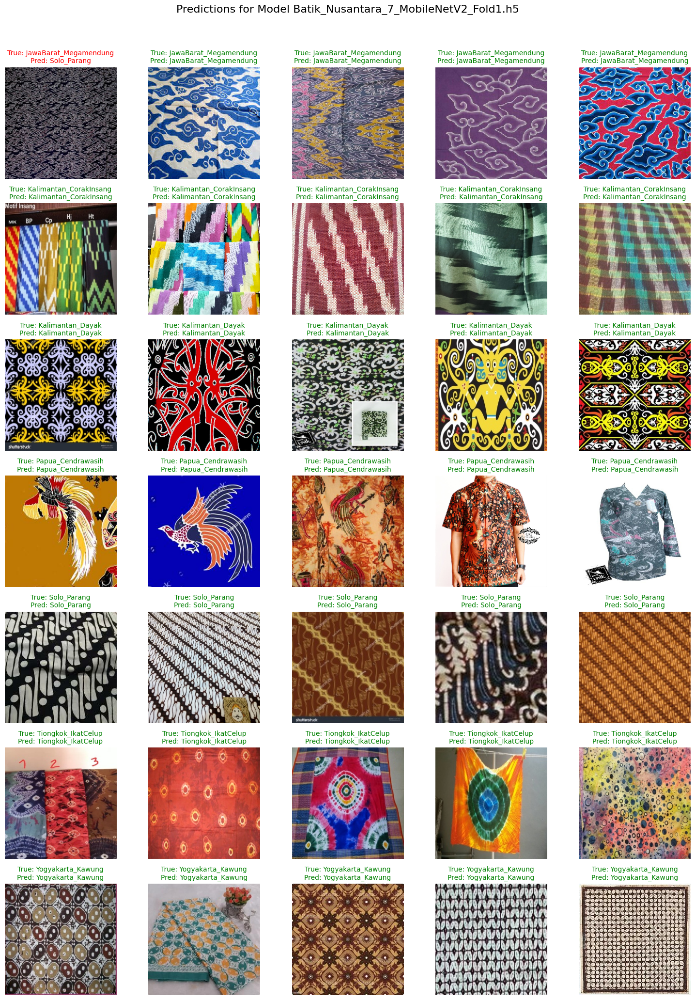

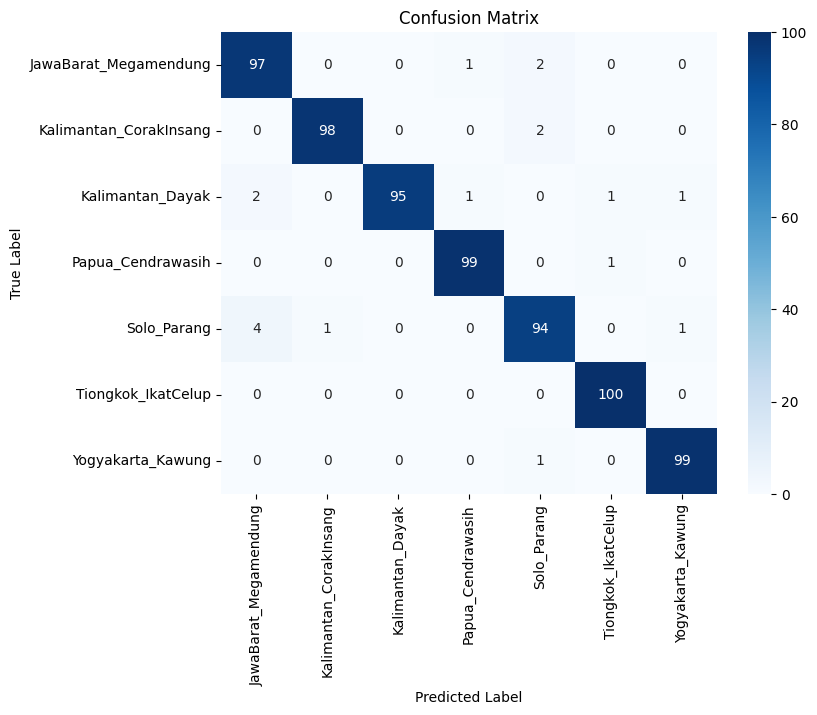

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.94      0.97      0.96       100
Kalimantan_CorakInsang       0.99      0.98      0.98       100
      Kalimantan_Dayak       1.00      0.95      0.97       100
     Papua_Cendrawasih       0.98      0.99      0.99       100
           Solo_Parang       0.95      0.94      0.94       100
    Tiongkok_IkatCelup       0.98      1.00      0.99       100
     Yogyakarta_Kawung       0.98      0.99      0.99       100

              accuracy                           0.97       700
             macro avg       0.97      0.97      0.97       700
          weighted avg       0.97      0.97      0.97       700



In [4]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold1.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_2124\3700777095.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


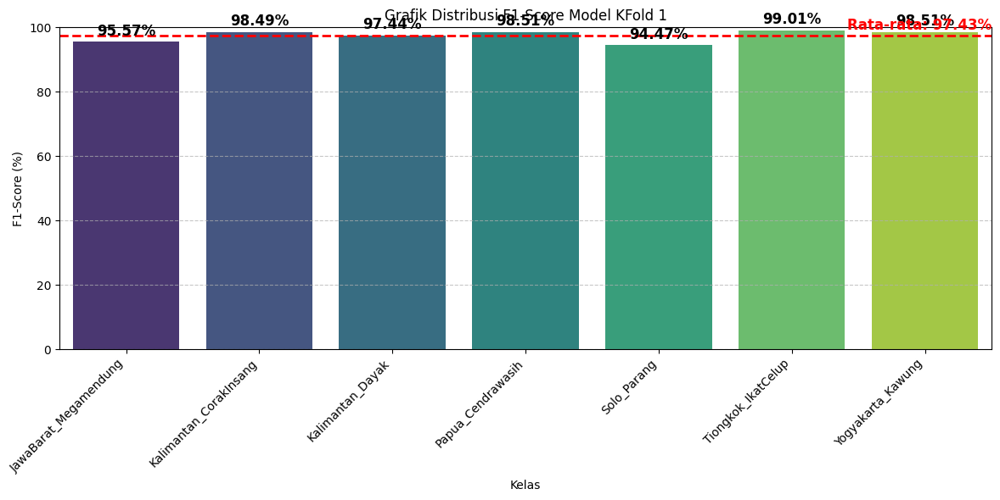

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 1")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 2

22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 828ms/step


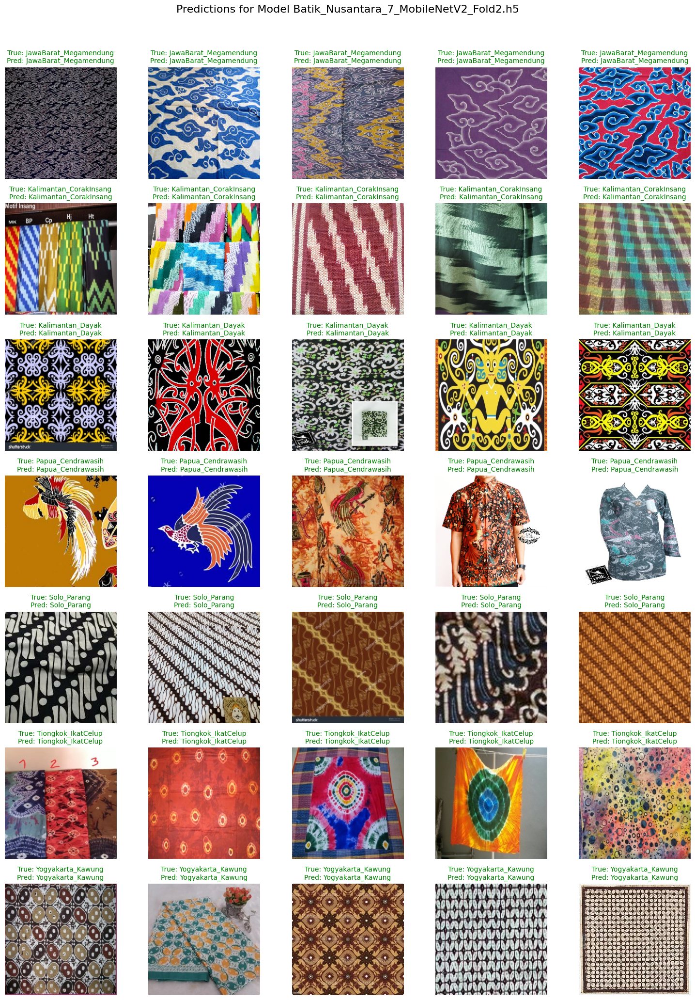

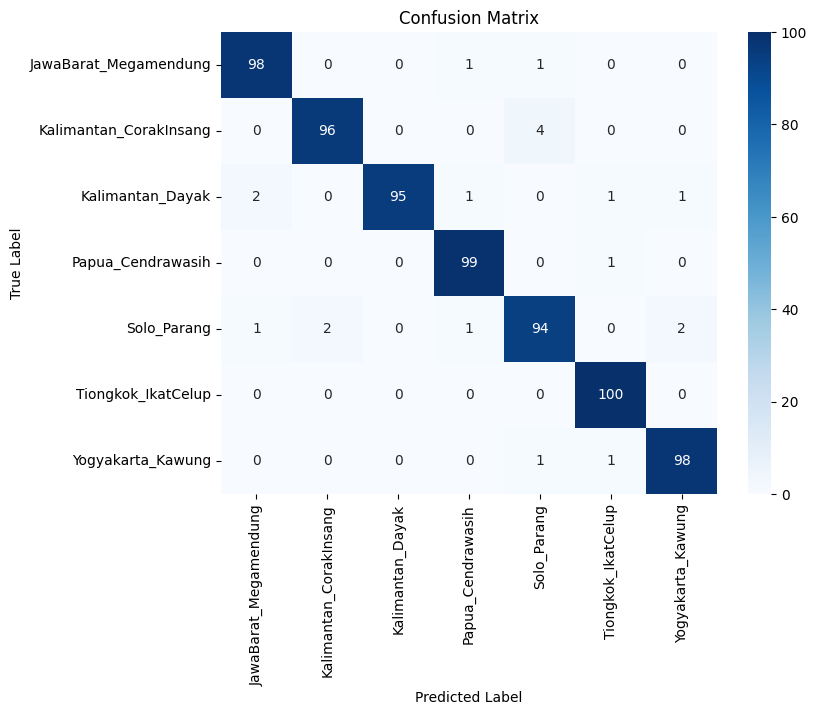

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.97      0.98      0.98       100
Kalimantan_CorakInsang       0.98      0.96      0.97       100
      Kalimantan_Dayak       1.00      0.95      0.97       100
     Papua_Cendrawasih       0.97      0.99      0.98       100
           Solo_Parang       0.94      0.94      0.94       100
    Tiongkok_IkatCelup       0.97      1.00      0.99       100
     Yogyakarta_Kawung       0.97      0.98      0.98       100

              accuracy                           0.97       700
             macro avg       0.97      0.97      0.97       700
          weighted avg       0.97      0.97      0.97       700



In [6]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold2.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_2124\2186660190.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


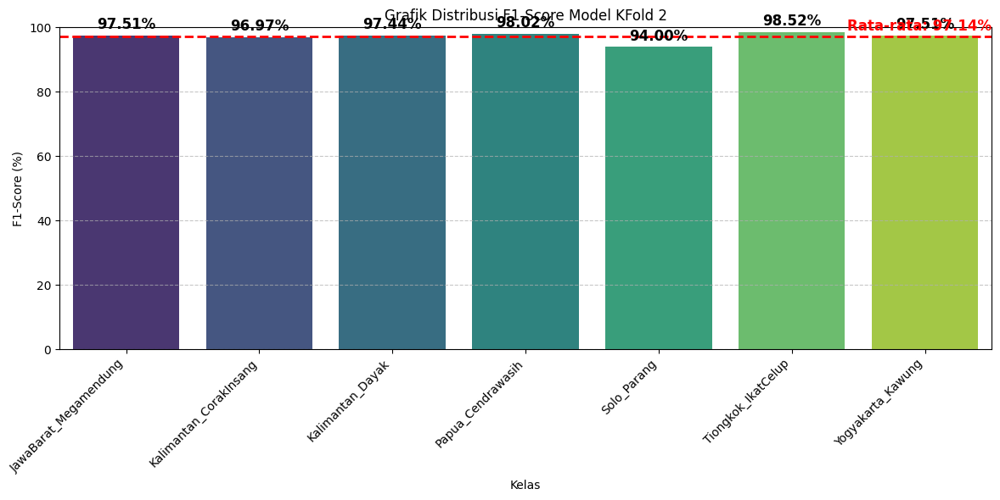

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 2")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 3

22/22 ━━━━━━━━━━━━━━━━━━━━ 18s 790ms/step


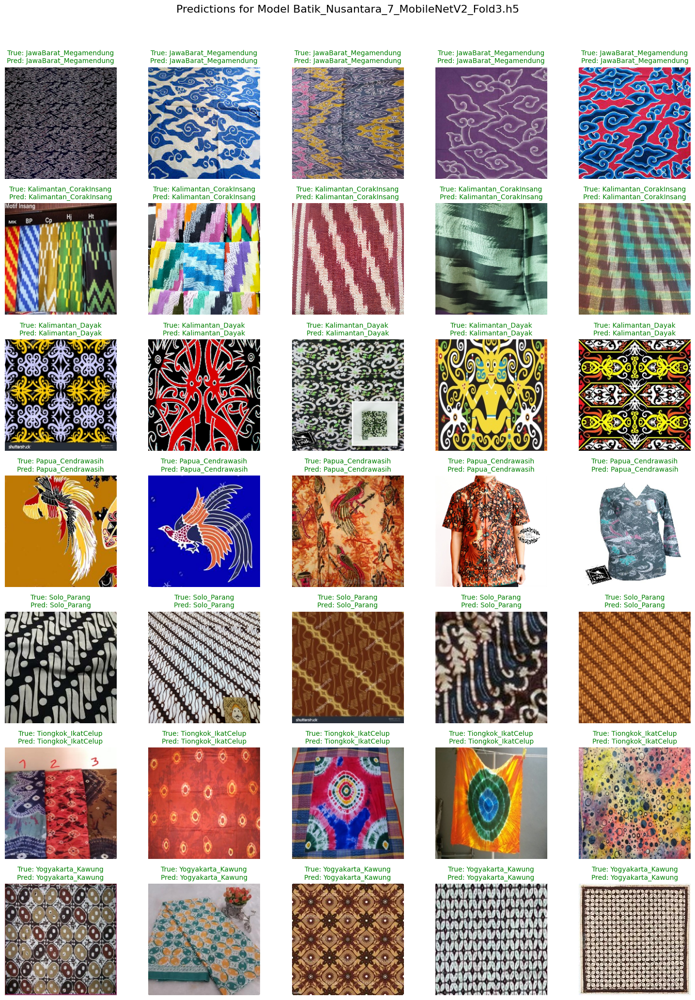

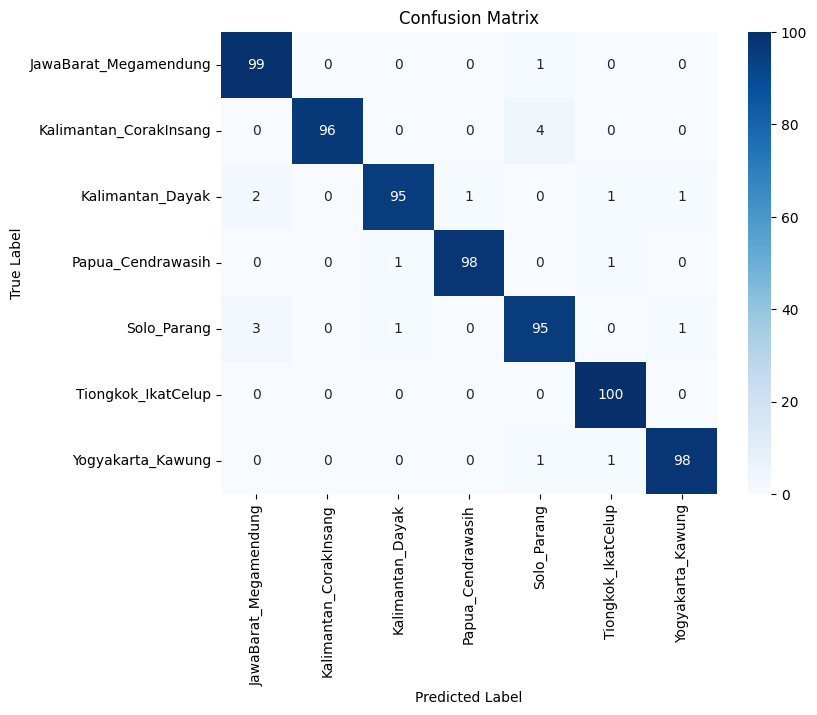

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.95      0.99      0.97       100
Kalimantan_CorakInsang       1.00      0.96      0.98       100
      Kalimantan_Dayak       0.98      0.95      0.96       100
     Papua_Cendrawasih       0.99      0.98      0.98       100
           Solo_Parang       0.94      0.95      0.95       100
    Tiongkok_IkatCelup       0.97      1.00      0.99       100
     Yogyakarta_Kawung       0.98      0.98      0.98       100

              accuracy                           0.97       700
             macro avg       0.97      0.97      0.97       700
          weighted avg       0.97      0.97      0.97       700



In [8]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold3.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_2124\358054296.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


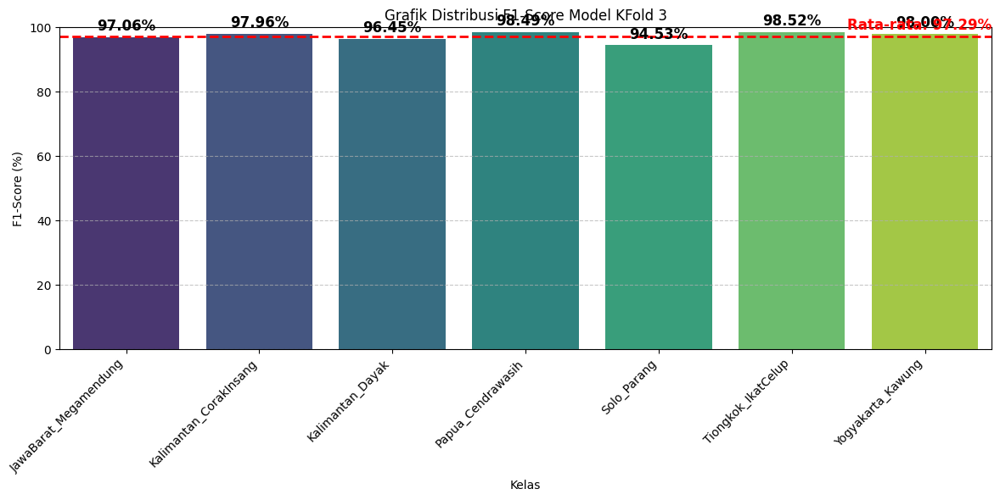

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 3")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 4

22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 810ms/step


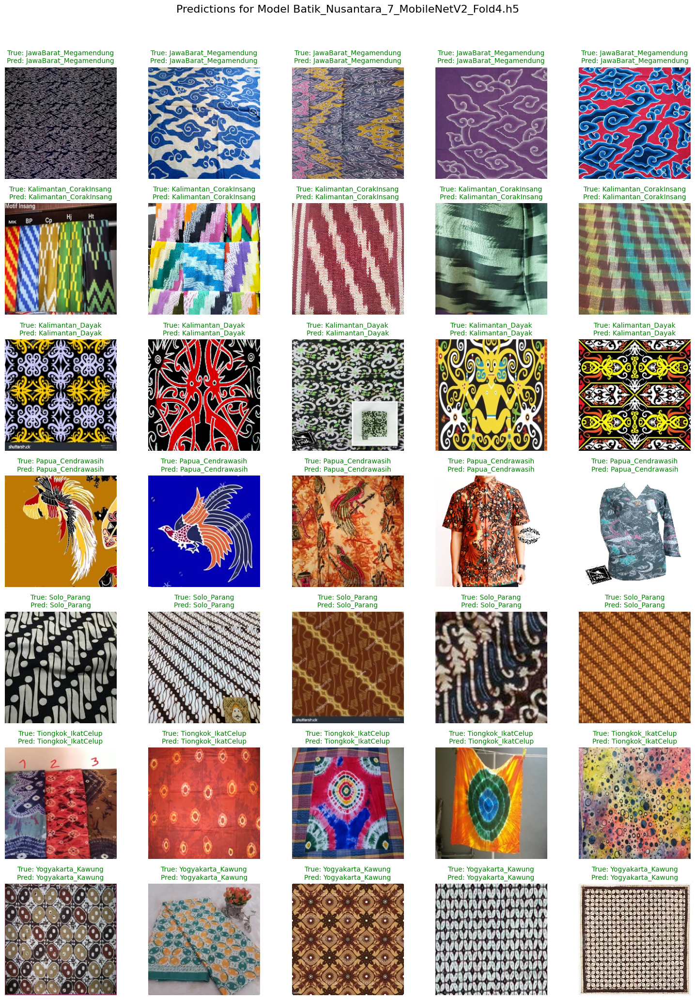

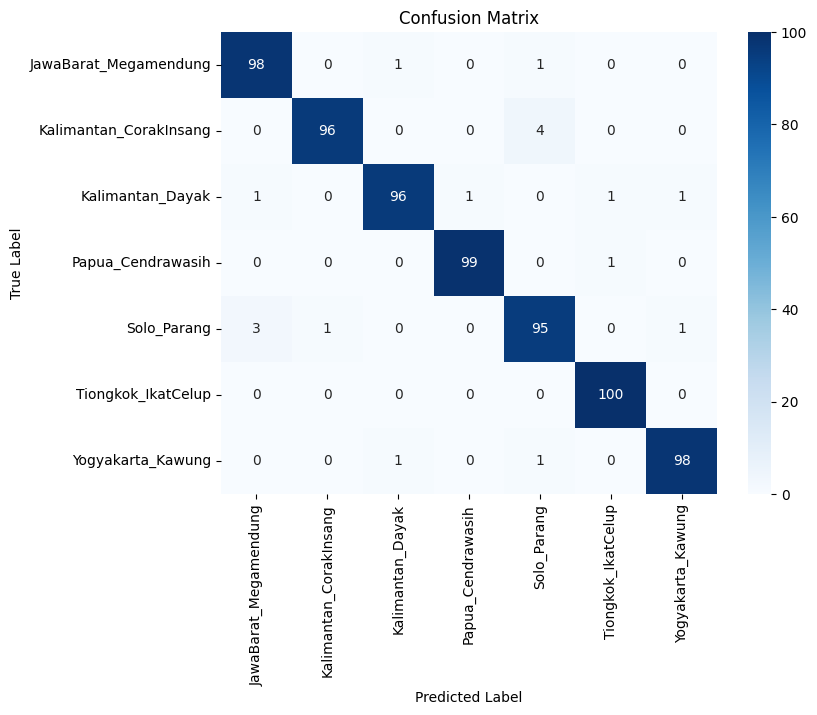

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.96      0.98      0.97       100
Kalimantan_CorakInsang       0.99      0.96      0.97       100
      Kalimantan_Dayak       0.98      0.96      0.97       100
     Papua_Cendrawasih       0.99      0.99      0.99       100
           Solo_Parang       0.94      0.95      0.95       100
    Tiongkok_IkatCelup       0.98      1.00      0.99       100
     Yogyakarta_Kawung       0.98      0.98      0.98       100

              accuracy                           0.97       700
             macro avg       0.97      0.97      0.97       700
          weighted avg       0.97      0.97      0.97       700



In [10]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold4.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_2124\276641823.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


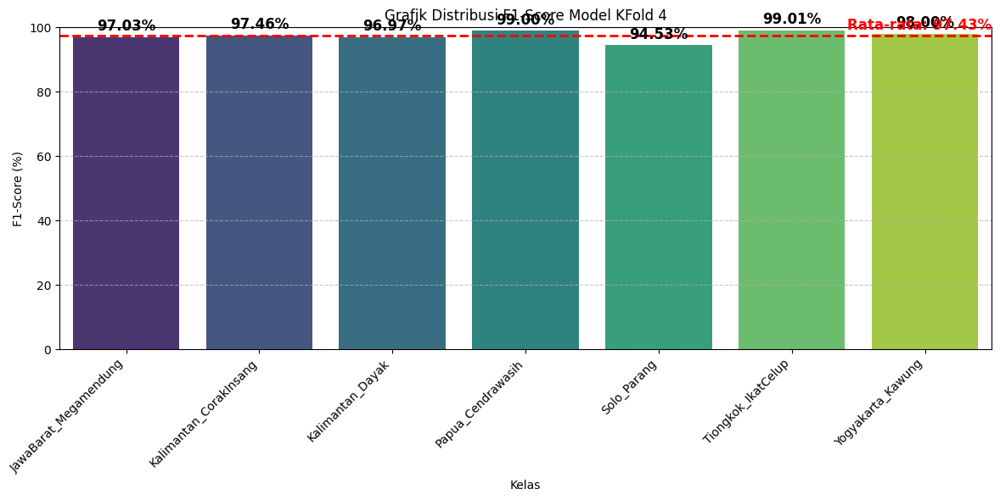

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 4")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 5

22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 807ms/step


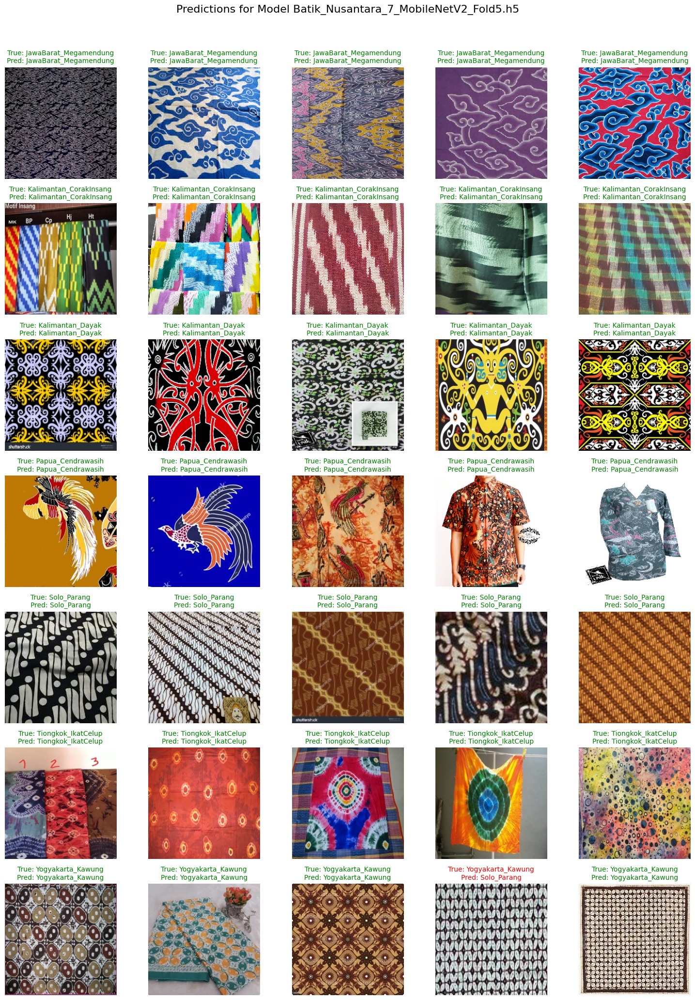

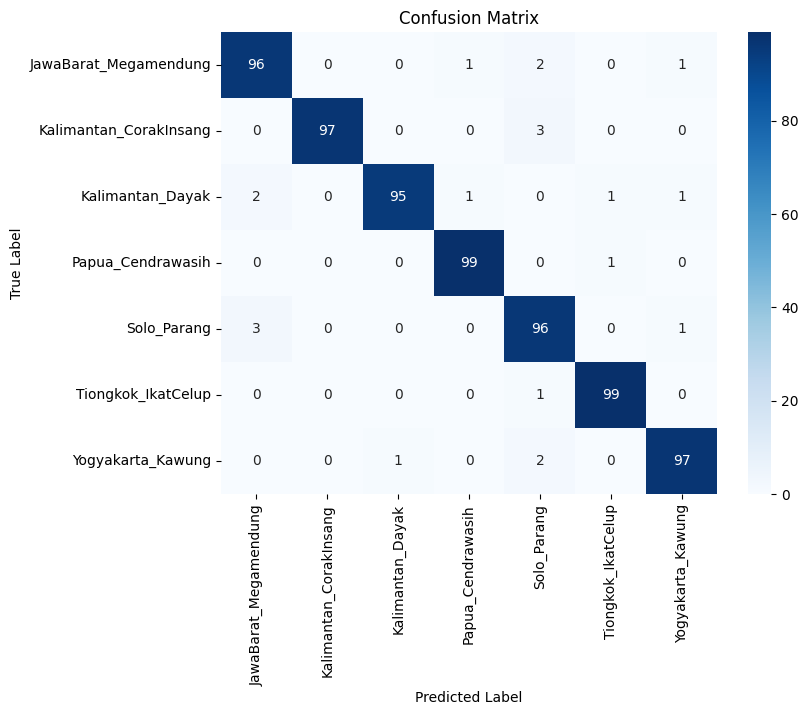

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.95      0.96      0.96       100
Kalimantan_CorakInsang       1.00      0.97      0.98       100
      Kalimantan_Dayak       0.99      0.95      0.97       100
     Papua_Cendrawasih       0.98      0.99      0.99       100
           Solo_Parang       0.92      0.96      0.94       100
    Tiongkok_IkatCelup       0.98      0.99      0.99       100
     Yogyakarta_Kawung       0.97      0.97      0.97       100

              accuracy                           0.97       700
             macro avg       0.97      0.97      0.97       700
          weighted avg       0.97      0.97      0.97       700



In [12]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold5.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_2124\4055511063.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


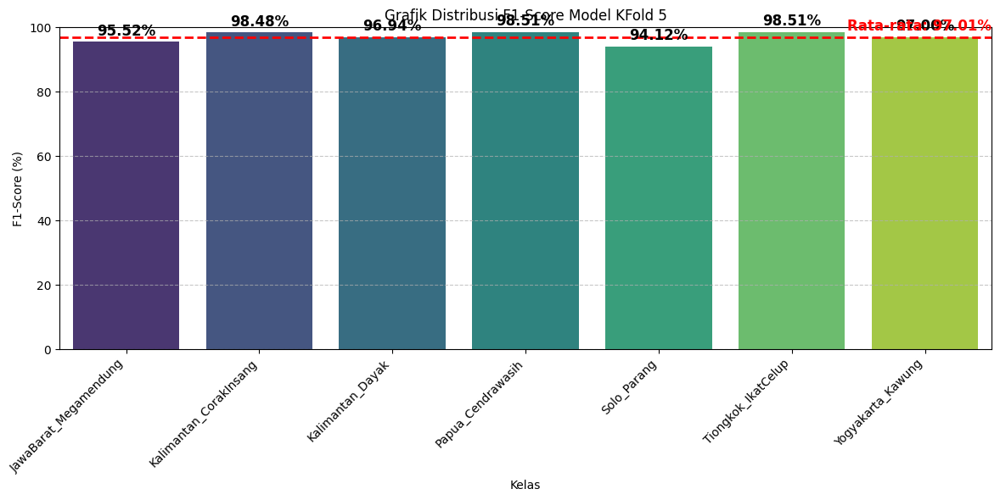

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 5")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input

# Load model
loaded_model = tf.keras.models.load_model('Batik_Nusantara_7_MobileNetV2_Fold4.h5')

# Path ke direktori testing dataset
dataset_test_dir = "../../Dataset_Testing"

# Ambil nama kelas dari model (bukan dari folder testing!)
class_names = sorted(os.listdir("../../Dataset/Dataset_Nusantara_7_augmented/augment"))
print("\nNama Kelas:", class_names, "\n")

# Loop setiap folder kelas dan gambar-gambarnya
for class_folder in os.listdir(dataset_test_dir):
    class_folder_path = os.path.join(dataset_test_dir, class_folder)

    # Lewati jika bukan folder
    if not os.path.isdir(class_folder_path):
        continue

    print(f"\n🔍 Kelas Asli (folder): {class_folder}")

    for img_name in os.listdir(class_folder_path):
        img_path = os.path.join(class_folder_path, img_name)

        try:
            # Load dan preprocess gambar
            img = image.load_img(img_path, target_size=(224, 224))
            img_array = image.img_to_array(img)
            img_array = np.expand_dims(img_array, axis=0)
            img_array = preprocess_input(img_array)

            # Prediksi
            predictions = loaded_model.predict(img_array)
            predicted_class_indices = np.argmax(predictions, axis=1)
            predicted_class_name = class_names[predicted_class_indices[0]]

            print(f"  📄 File: {img_name} | Actual: {class_folder:<20} | Prediksi: {predicted_class_name}")

        except Exception as e:
            print(f"  ❌ Gagal memproses gambar: {img_name}, error: {e}")



Nama Kelas: ['JawaBarat_Megamendung', 'Kalimantan_CorakInsang', 'Kalimantan_Dayak', 'Papua_Cendrawasih', 'Solo_Parang', 'Tiongkok_IkatCelup', 'Yogyakarta_Kawung'] 


🔍 Kelas Asli (folder): JawaBarat_Megamendung

🔍 Kelas Asli (folder): Kalimantan_CorakInsang
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 980ms/step
  📄 File: test_corakinsang.jpg | Actual: Kalimantan_CorakInsang | Prediksi: Kalimantan_CorakInsang
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
  📄 File: test_corakinsang2.jpg | Actual: Kalimantan_CorakInsang | Prediksi: Kalimantan_CorakInsang
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
  📄 File: test_corakinsang3.jpg | Actual: Kalimantan_CorakInsang | Prediksi: Kalimantan_CorakInsang

🔍 Kelas Asli (folder): Kalimantan_Dayak
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
  📄 File: test_dayak.jpg | Actual: Kalimantan_Dayak     | Prediksi: Kalimantan_Dayak
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
  📄 File: test_dayak2.jpg | Actual: Kalimantan_Dayak     | Prediksi: Kalimantan_Dayak

🔍 Kelas Asli (folder): Papua_Cendrawas

In [15]:
import numpy as np

# Contoh hasil akurasi dari 5 fold 
accuracies = [ 97.43, 97.14, 97.29, 97.43, 97.00 ]

# Menghitung standar deviasi
std_dev = np.std(accuracies)
mean = np.mean(accuracies)

print(f"standar Deviasi Akurasi Model: {std_dev:.4f}")
print(f"Rata-rata akurasi Model: {mean:.2f}")

standar Deviasi Akurasi Model: 0.1677
Rata-rata akurasi Model: 97.26
